In [2]:
import torch
import torchvision.transforms as transforms
from torchvision.models import vit_b_16, ViT_B_16_Weights
from torch.utils.data import DataLoader 
from torchvision.datasets import ImageFolder 
import numpy as np
from sklearn.metrics import normalized_mutual_info_score, adjusted_rand_score, f1_score, accuracy_score
import matplotlib.pyplot as plt
from tqdm import tqdm
from finch import FINCH
from sklearn.manifold import TSNE

In [3]:
# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [ ]:
train_transform = transforms.Compose([
    transforms.RandAugment(),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
])

test_transform = transforms.Compose([ 
    transforms.ToTensor(), 
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) 
])

# train_folder = r"C:\Users\HP\novelty\NCD_dataset\train" 
train_folder = r"C:\Users\HP\novelty\dataset"
test_folder = r"C:\Users\HP\novelty\NCD_dataset\test" 
unlabel_folder = r"C:\Users\HP\novelty\NCD_dataset\unlabeled"

train_dataset = ImageFolder(root=train_folder, 
transform=train_transform) 
print(f"Total gambar dalam train dataset: {len(train_dataset)} {len(train_dataset.classes)}")
# test_dataset = ImageFolder(root=test_folder, 
# transform=test_transform) 
# print(f"Total gambar dalam test dataset: {len(test_dataset)}  {len(test_dataset.classes)}")
# unlabel_dataset = ImageFolder(root=unlabel_folder, 
# transform=test_transform) 
# print(f"Total gambar dalam unlabel dataset: {len(unlabel_dataset)}  {len(unlabel_dataset.classes)}")

batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, 
shuffle=True) 
# print(f"Total loader gambar dalam train dataset: {len(train_loader)}")
# test_loader = DataLoader(test_dataset, batch_size=batch_size, 
# shuffle=False)
# print(f"Total loader gambar dalam test dataset: {len(test_loader)}")
# unlabel_loader = DataLoader(unlabel_dataset, batch_size=batch_size, 
# shuffle=False)
# print(f"Total loader gambar dalam unlabel dataset: {len(unlabel_loader)}")

Total gambar dalam train dataset: 5200 52
Total gambar dalam test dataset: 1280  32
Total gambar dalam unlabel dataset: 2000  20
Total loader gambar dalam train dataset: 163
Total loader gambar dalam test dataset: 40
Total loader gambar dalam unlabel dataset: 63


In [ ]:
# Load model ViT_b_16 dengan weights pre-trained
model = vit_b_16(weights=ViT_B_16_Weights.IMAGENET1K_V1)

model.heads = torch.nn.Linear(model.heads.head.in_features, len(train_dataset.classes))
model = model.to(device)

# Loss function dan optimizer
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
print(model.encoder.layers[0].mlp[1])

GELU(approximate='none')


In [16]:
# Fungsi untuk ekstraksi fitur
def extract_features(loader, model):
    features = []
    labels = []
    model.eval()
    with torch.no_grad():
        for images, targets in tqdm(loader, desc="Extracting features"):
            images = images.to(device)
            feat = model(images)
            print("Output shape:", feat.shape)
            features.append(feat.cpu().numpy())
            labels.append(targets.numpy())
    return np.concatenate(features), np.concatenate(labels)

In [ ]:
# Training loop
def train_model(model, train_loader, val_loader, epochs=10):
    model.to(device)

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        
        for images, labels in tqdm(train_loader, desc=f"Training Epoch {epoch+1}/{epochs}"):
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        train_acc = 100 * correct / total
        train_loss = running_loss / len(train_loader)
        print(f"\nEpoch {epoch+1} | Train Loss: {train_loss:.4f} | Train Accuracy: {train_acc:.2f}%")

        evaluate_model(model, val_loader)


# Evaluation function
def evaluate_model(model, val_loader):
    model.eval()
    all_preds = []
    all_labels = []
    val_loss = 0.0

    with torch.no_grad():
        for images, labels in tqdm(val_loader, desc="Evaluating"):
            images, labels = images.to(device), labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    # Metrics
    acc = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average='weighted')

    print(f"Validation Loss: {val_loss / len(val_loader):.4f}")
    print(f"Validation Accuracy: {acc * 100:.2f}%")
    print(f"Validation F1 Score: {f1:.4f}")

train_model(model, train_loader, test_loader, epochs=20)

torch.save(model.state_dict(), "vit_b16_bbg52_known.pth")

Training Epoch 1/20: 100%|██████████| 60/60 [00:55<00:00,  1.07it/s]



Epoch 1 | Train Loss: 1.2783 | Train Accuracy: 70.31%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.38it/s]


Validation Loss: 0.7039
Validation Accuracy: 80.23%
Validation F1 Score: 0.7947


Training Epoch 2/20: 100%|██████████| 60/60 [00:51<00:00,  1.17it/s]



Epoch 2 | Train Loss: 0.2175 | Train Accuracy: 95.89%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.47it/s]


Validation Loss: 0.5714
Validation Accuracy: 85.31%
Validation F1 Score: 0.8474


Training Epoch 3/20: 100%|██████████| 60/60 [00:51<00:00,  1.18it/s]



Epoch 3 | Train Loss: 0.1182 | Train Accuracy: 97.55%


Evaluating: 100%|██████████| 40/40 [00:10<00:00,  3.65it/s]


Validation Loss: 0.4913
Validation Accuracy: 85.78%
Validation F1 Score: 0.8555


Training Epoch 4/20: 100%|██████████| 60/60 [00:51<00:00,  1.17it/s]



Epoch 4 | Train Loss: 0.0923 | Train Accuracy: 97.86%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.61it/s]


Validation Loss: 0.4580
Validation Accuracy: 87.97%
Validation F1 Score: 0.8759


Training Epoch 5/20: 100%|██████████| 60/60 [00:50<00:00,  1.18it/s]



Epoch 5 | Train Loss: 0.0347 | Train Accuracy: 99.43%


Evaluating: 100%|██████████| 40/40 [00:10<00:00,  3.66it/s]


Validation Loss: 0.4144
Validation Accuracy: 87.11%
Validation F1 Score: 0.8685


Training Epoch 6/20: 100%|██████████| 60/60 [00:50<00:00,  1.19it/s]



Epoch 6 | Train Loss: 0.0756 | Train Accuracy: 97.81%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.57it/s]


Validation Loss: 0.4768
Validation Accuracy: 86.09%
Validation F1 Score: 0.8631


Training Epoch 7/20: 100%|██████████| 60/60 [00:53<00:00,  1.11it/s]



Epoch 7 | Train Loss: 0.0729 | Train Accuracy: 98.33%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.43it/s]


Validation Loss: 0.4675
Validation Accuracy: 87.58%
Validation F1 Score: 0.8760


Training Epoch 8/20: 100%|██████████| 60/60 [00:54<00:00,  1.11it/s]



Epoch 8 | Train Loss: 0.0676 | Train Accuracy: 97.92%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.45it/s]


Validation Loss: 0.5159
Validation Accuracy: 85.70%
Validation F1 Score: 0.8571


Training Epoch 9/20: 100%|██████████| 60/60 [00:53<00:00,  1.12it/s]



Epoch 9 | Train Loss: 0.0758 | Train Accuracy: 97.60%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.36it/s]


Validation Loss: 0.4236
Validation Accuracy: 87.97%
Validation F1 Score: 0.8789


Training Epoch 10/20: 100%|██████████| 60/60 [00:53<00:00,  1.11it/s]



Epoch 10 | Train Loss: 0.0292 | Train Accuracy: 99.32%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.43it/s]


Validation Loss: 0.5178
Validation Accuracy: 87.73%
Validation F1 Score: 0.8733


Training Epoch 11/20: 100%|██████████| 60/60 [00:53<00:00,  1.12it/s]



Epoch 11 | Train Loss: 0.0371 | Train Accuracy: 99.11%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.36it/s]


Validation Loss: 0.6407
Validation Accuracy: 84.30%
Validation F1 Score: 0.8413


Training Epoch 12/20: 100%|██████████| 60/60 [00:54<00:00,  1.11it/s]



Epoch 12 | Train Loss: 0.0453 | Train Accuracy: 98.80%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.40it/s]


Validation Loss: 0.6999
Validation Accuracy: 81.33%
Validation F1 Score: 0.8101


Training Epoch 13/20: 100%|██████████| 60/60 [00:53<00:00,  1.11it/s]



Epoch 13 | Train Loss: 0.0835 | Train Accuracy: 97.86%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.43it/s]


Validation Loss: 0.4615
Validation Accuracy: 86.33%
Validation F1 Score: 0.8601


Training Epoch 14/20: 100%|██████████| 60/60 [00:53<00:00,  1.11it/s]



Epoch 14 | Train Loss: 0.0265 | Train Accuracy: 99.48%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.44it/s]


Validation Loss: 0.4376
Validation Accuracy: 88.83%
Validation F1 Score: 0.8809


Training Epoch 15/20: 100%|██████████| 60/60 [00:53<00:00,  1.11it/s]



Epoch 15 | Train Loss: 0.0629 | Train Accuracy: 98.59%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.40it/s]


Validation Loss: 0.5425
Validation Accuracy: 86.02%
Validation F1 Score: 0.8570


Training Epoch 16/20: 100%|██████████| 60/60 [00:54<00:00,  1.10it/s]



Epoch 16 | Train Loss: 0.0542 | Train Accuracy: 98.70%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.40it/s]


Validation Loss: 0.4620
Validation Accuracy: 87.97%
Validation F1 Score: 0.8794


Training Epoch 17/20: 100%|██████████| 60/60 [00:53<00:00,  1.11it/s]



Epoch 17 | Train Loss: 0.0448 | Train Accuracy: 98.91%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.43it/s]


Validation Loss: 0.4721
Validation Accuracy: 88.05%
Validation F1 Score: 0.8778


Training Epoch 18/20: 100%|██████████| 60/60 [00:53<00:00,  1.11it/s]



Epoch 18 | Train Loss: 0.0408 | Train Accuracy: 98.96%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.44it/s]


Validation Loss: 0.5284
Validation Accuracy: 87.50%
Validation F1 Score: 0.8717


Training Epoch 19/20: 100%|██████████| 60/60 [00:53<00:00,  1.12it/s]



Epoch 19 | Train Loss: 0.0349 | Train Accuracy: 99.17%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.45it/s]


Validation Loss: 0.4826
Validation Accuracy: 86.88%
Validation F1 Score: 0.8661


Training Epoch 20/20: 100%|██████████| 60/60 [00:53<00:00,  1.11it/s]



Epoch 20 | Train Loss: 0.0365 | Train Accuracy: 98.85%


Evaluating: 100%|██████████| 40/40 [00:11<00:00,  3.43it/s]


Validation Loss: 0.5938
Validation Accuracy: 84.77%
Validation F1 Score: 0.8516


In [ ]:
model = vit_b_16(weights=None)
model.heads = torch.nn.Identity()  # Hapus classification head
model.load_state_dict(torch.load("vit_b16_bbg52_known.pth"),strict=False)
model = model.to(device)
model.eval()

# Ekstrak fitur dari unlabeled data
unlabeled_features, unlabeled_true_labels = extract_features(unlabel_loader, model)

C:\Users\HP\AppData\Local\Temp\ipykernel_6528\2019275273.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("vit_b16_bbg52_known.pth"),stri

Output shape: torch.Size([32, 768])


Extracting features:   2%|▏         | 1/63 [00:00<00:21,  2.94it/s]

Output shape: torch.Size([32, 768])


Extracting features:   3%|▎         | 2/63 [00:00<00:18,  3.29it/s]

Output shape: torch.Size([32, 768])


Extracting features:   5%|▍         | 3/63 [00:00<00:17,  3.35it/s]

Output shape: torch.Size([32, 768])


Extracting features:   6%|▋         | 4/63 [00:01<00:16,  3.47it/s]

Output shape: torch.Size([32, 768])


Extracting features:   8%|▊         | 5/63 [00:01<00:16,  3.50it/s]

Output shape: torch.Size([32, 768])


Extracting features:  10%|▉         | 6/63 [00:01<00:16,  3.51it/s]

Output shape: torch.Size([32, 768])


Extracting features:  11%|█         | 7/63 [00:02<00:15,  3.55it/s]

Output shape: torch.Size([32, 768])


Extracting features:  13%|█▎        | 8/63 [00:02<00:15,  3.56it/s]

Output shape: torch.Size([32, 768])


Extracting features:  14%|█▍        | 9/63 [00:02<00:15,  3.55it/s]

Output shape: torch.Size([32, 768])


Extracting features:  16%|█▌        | 10/63 [00:02<00:14,  3.55it/s]

Output shape: torch.Size([32, 768])


Extracting features:  17%|█▋        | 11/63 [00:03<00:14,  3.57it/s]

Output shape: torch.Size([32, 768])


Extracting features:  19%|█▉        | 12/63 [00:03<00:14,  3.58it/s]

Output shape: torch.Size([32, 768])


Extracting features:  21%|██        | 13/63 [00:03<00:13,  3.60it/s]

Output shape: torch.Size([32, 768])


Extracting features:  22%|██▏       | 14/63 [00:03<00:13,  3.55it/s]

Output shape: torch.Size([32, 768])


Extracting features:  24%|██▍       | 15/63 [00:04<00:13,  3.48it/s]

Output shape: torch.Size([32, 768])


Extracting features:  25%|██▌       | 16/63 [00:04<00:13,  3.53it/s]

Output shape: torch.Size([32, 768])


Extracting features:  27%|██▋       | 17/63 [00:04<00:12,  3.58it/s]

Output shape: torch.Size([32, 768])


Extracting features:  29%|██▊       | 18/63 [00:05<00:12,  3.55it/s]

Output shape: torch.Size([32, 768])


Extracting features:  30%|███       | 19/63 [00:05<00:12,  3.58it/s]

Output shape: torch.Size([32, 768])


Extracting features:  32%|███▏      | 20/63 [00:05<00:11,  3.60it/s]

Output shape: torch.Size([32, 768])


Extracting features:  33%|███▎      | 21/63 [00:05<00:11,  3.61it/s]

Output shape: torch.Size([32, 768])


Extracting features:  35%|███▍      | 22/63 [00:06<00:11,  3.58it/s]

Output shape: torch.Size([32, 768])


Extracting features:  37%|███▋      | 23/63 [00:06<00:11,  3.57it/s]

Output shape: torch.Size([32, 768])


Extracting features:  38%|███▊      | 24/63 [00:06<00:10,  3.57it/s]

Output shape: torch.Size([32, 768])


Extracting features:  40%|███▉      | 25/63 [00:07<00:10,  3.56it/s]

Output shape: torch.Size([32, 768])


Extracting features:  41%|████▏     | 26/63 [00:07<00:10,  3.57it/s]

Output shape: torch.Size([32, 768])


Extracting features:  43%|████▎     | 27/63 [00:07<00:10,  3.58it/s]

Output shape: torch.Size([32, 768])


Extracting features:  44%|████▍     | 28/63 [00:07<00:09,  3.57it/s]

Output shape: torch.Size([32, 768])


Extracting features:  46%|████▌     | 29/63 [00:08<00:09,  3.55it/s]

Output shape: torch.Size([32, 768])


Extracting features:  48%|████▊     | 30/63 [00:08<00:09,  3.57it/s]

Output shape: torch.Size([32, 768])


Extracting features:  49%|████▉     | 31/63 [00:08<00:09,  3.50it/s]

Output shape: torch.Size([32, 768])


Extracting features:  51%|█████     | 32/63 [00:09<00:08,  3.47it/s]

Output shape: torch.Size([32, 768])


Extracting features:  52%|█████▏    | 33/63 [00:09<00:08,  3.49it/s]

Output shape: torch.Size([32, 768])


Extracting features:  54%|█████▍    | 34/63 [00:09<00:08,  3.52it/s]

Output shape: torch.Size([32, 768])


Extracting features:  56%|█████▌    | 35/63 [00:09<00:07,  3.51it/s]

Output shape: torch.Size([32, 768])


Extracting features:  57%|█████▋    | 36/63 [00:10<00:07,  3.52it/s]

Output shape: torch.Size([32, 768])


Extracting features:  59%|█████▊    | 37/63 [00:10<00:07,  3.56it/s]

Output shape: torch.Size([32, 768])


Extracting features:  60%|██████    | 38/63 [00:10<00:06,  3.58it/s]

Output shape: torch.Size([32, 768])


Extracting features:  62%|██████▏   | 39/63 [00:11<00:06,  3.56it/s]

Output shape: torch.Size([32, 768])


Extracting features:  63%|██████▎   | 40/63 [00:11<00:06,  3.56it/s]

Output shape: torch.Size([32, 768])


Extracting features:  65%|██████▌   | 41/63 [00:11<00:06,  3.57it/s]

Output shape: torch.Size([32, 768])


Extracting features:  67%|██████▋   | 42/63 [00:11<00:05,  3.56it/s]

Output shape: torch.Size([32, 768])


Extracting features:  68%|██████▊   | 43/63 [00:12<00:05,  3.50it/s]

Output shape: torch.Size([32, 768])


Extracting features:  70%|██████▉   | 44/63 [00:12<00:05,  3.50it/s]

Output shape: torch.Size([32, 768])


Extracting features:  71%|███████▏  | 45/63 [00:12<00:05,  3.43it/s]

Output shape: torch.Size([32, 768])


Extracting features:  73%|███████▎  | 46/63 [00:13<00:04,  3.43it/s]

Output shape: torch.Size([32, 768])


Extracting features:  75%|███████▍  | 47/63 [00:13<00:04,  3.44it/s]

Output shape: torch.Size([32, 768])


Extracting features:  76%|███████▌  | 48/63 [00:13<00:04,  3.44it/s]

Output shape: torch.Size([32, 768])


Extracting features:  78%|███████▊  | 49/63 [00:13<00:04,  3.42it/s]

Output shape: torch.Size([32, 768])


Extracting features:  79%|███████▉  | 50/63 [00:14<00:03,  3.42it/s]

Output shape: torch.Size([32, 768])


Extracting features:  81%|████████  | 51/63 [00:14<00:03,  3.43it/s]

Output shape: torch.Size([32, 768])


Extracting features:  83%|████████▎ | 52/63 [00:14<00:03,  3.44it/s]

Output shape: torch.Size([32, 768])


Extracting features:  84%|████████▍ | 53/63 [00:15<00:02,  3.43it/s]

Output shape: torch.Size([32, 768])


Extracting features:  86%|████████▌ | 54/63 [00:15<00:02,  3.41it/s]

Output shape: torch.Size([32, 768])


Extracting features:  87%|████████▋ | 55/63 [00:15<00:02,  3.42it/s]

Output shape: torch.Size([32, 768])


Extracting features:  89%|████████▉ | 56/63 [00:15<00:02,  3.42it/s]

Output shape: torch.Size([32, 768])


Extracting features:  90%|█████████ | 57/63 [00:16<00:01,  3.41it/s]

Output shape: torch.Size([32, 768])


Extracting features:  92%|█████████▏| 58/63 [00:16<00:01,  3.40it/s]

Output shape: torch.Size([32, 768])


Extracting features:  94%|█████████▎| 59/63 [00:16<00:01,  3.41it/s]

Output shape: torch.Size([32, 768])


Extracting features:  95%|█████████▌| 60/63 [00:17<00:00,  3.41it/s]

Output shape: torch.Size([32, 768])


Extracting features:  97%|█████████▋| 61/63 [00:17<00:00,  3.39it/s]

Output shape: torch.Size([32, 768])


Extracting features: 100%|██████████| 63/63 [00:17<00:00,  3.52it/s]

Output shape: torch.Size([16, 768])


In [41]:
c, num_clust, req_c = FINCH(unlabeled_features, req_clust=None, distance='euclidean', use_ann_above_samples=1000, verbose=True)
clusters = c[:,2]

nmi = normalized_mutual_info_score(unlabeled_true_labels, clusters)
ari = adjusted_rand_score(unlabeled_true_labels, clusters)

print(f"\nFINCH Clustering Performance:")
print(f"Normalized Mutual Information (NMI): {nmi:.4f}")
print(f"Adjusted Rand Index (ARI): {ari:.4f}")
print(f"Number of clusters found: {len(np.unique(clusters))}")

Using PyNNDescent to compute 1st-neighbours at this step ...
Step PyNNDescent done ...
Partition 0: 436 clusters
Partition 1: 87 clusters
Partition 2: 23 clusters
Partition 3: 7 clusters
Partition 4: 3 clusters

FINCH Clustering Performance:
Normalized Mutual Information (NMI): 0.9059
Adjusted Rand Index (ARI): 0.8061
Number of clusters found: 23


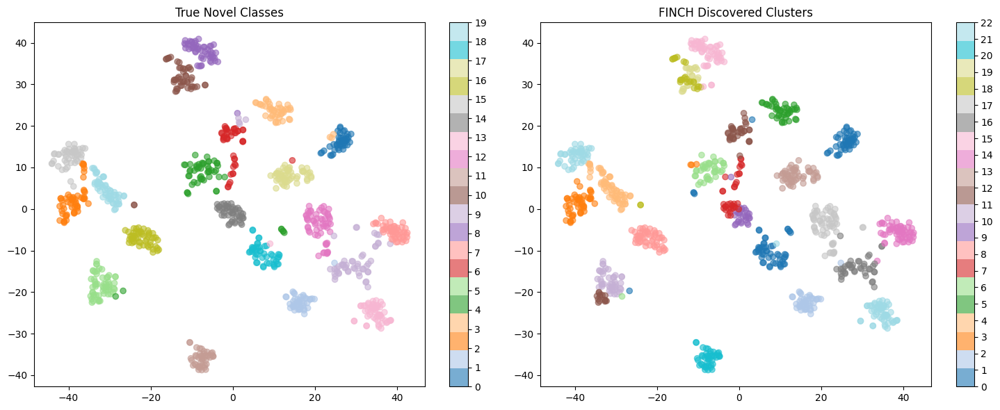


Cluster 0 (Total samples: 102)
True label distribution:
- Acalypha siamensis Oliv. ex Gage: 98 samples
- Allamanda cathartica L: 4 samples


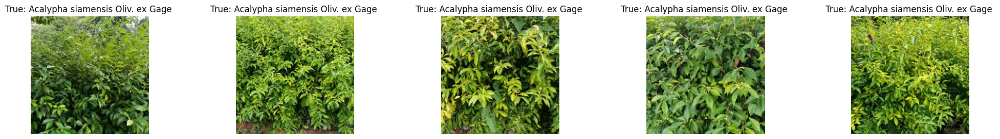


Cluster 1 (Total samples: 121)
True label distribution:
- Acalypha siamensis Oliv. ex Gage: 2 samples
- Alocasia macrorrhizos: 17 samples
- Bougainvillea spectabilis: 1 samples
- Costus woodsonii Maas: 2 samples
- Excoecaria cochinchinensis Lour: 99 samples


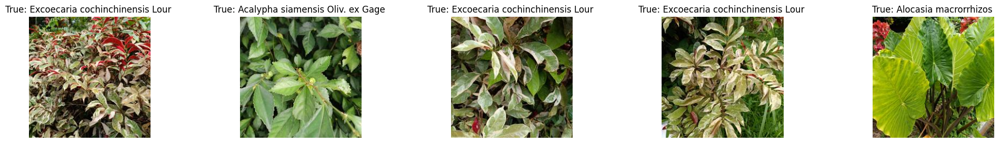


Cluster 2 (Total samples: 100)
True label distribution:
- Acalypha wilkesiana Müll.Arg: 100 samples


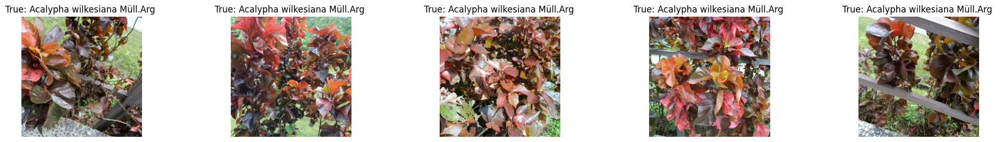


Cluster 3 (Total samples: 92)
True label distribution:
- Agave demeesteriana Jacobi: 84 samples
- Alocasia macrorrhizos: 6 samples
- Dracaena reflexa Lam: 2 samples


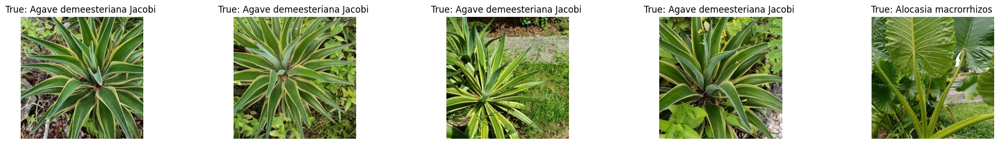


Cluster 4 (Total samples: 116)
True label distribution:
- Agave demeesteriana Jacobi: 16 samples
- Furcraea foetida (L.) Haw: 100 samples


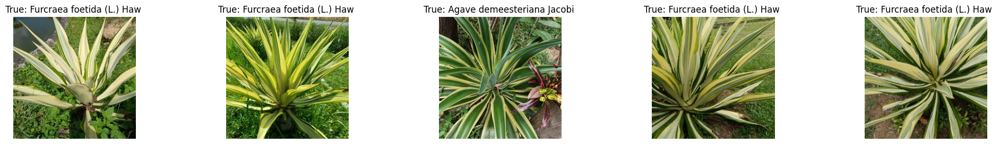


Cluster 5 (Total samples: 95)
True label distribution:
- Allamanda cathartica L: 95 samples


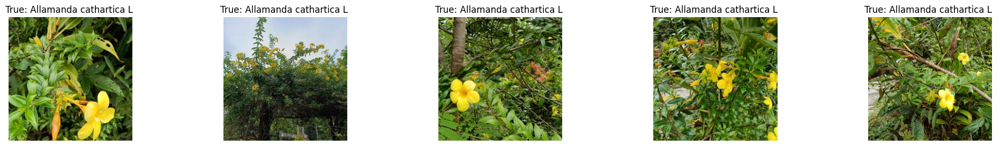


Cluster 6 (Total samples: 73)
True label distribution:
- Allamanda cathartica L: 1 samples
- Alocasia macrorrhizos: 72 samples


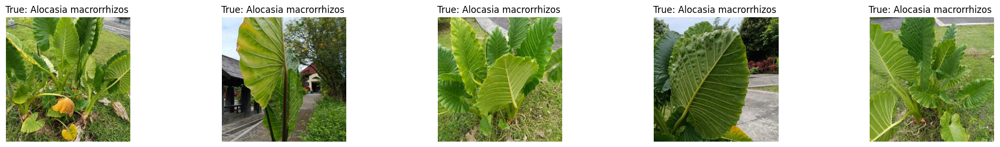


Cluster 7 (Total samples: 73)
True label distribution:
- Alocasia macrorrhizos: 3 samples
- Amorphophallus paeoniifolius (Dennst.) Nicolson: 30 samples
- Ctenanthe burle-marxii H.Kenn: 40 samples


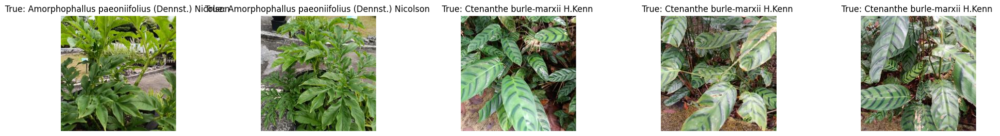


Cluster 8 (Total samples: 101)
True label distribution:
- Alocasia macrorrhizos: 1 samples
- Dracaena trifasciata (Prain) Mabb: 100 samples


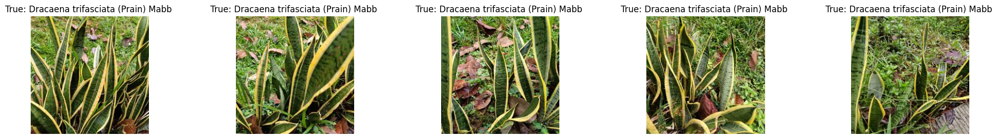


Cluster 9 (Total samples: 61)
True label distribution:
- Alocasia macrorrhizos: 1 samples
- Ctenanthe burle-marxii H.Kenn: 60 samples


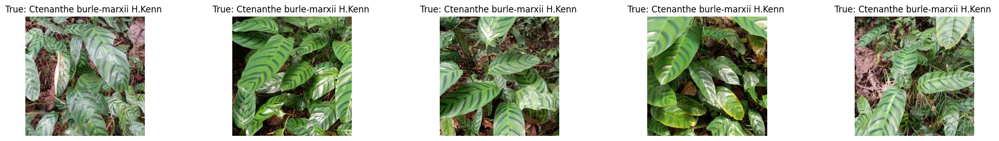


Cluster 10 (Total samples: 78)
True label distribution:
- Aloe vera (L.) Burm.f: 78 samples


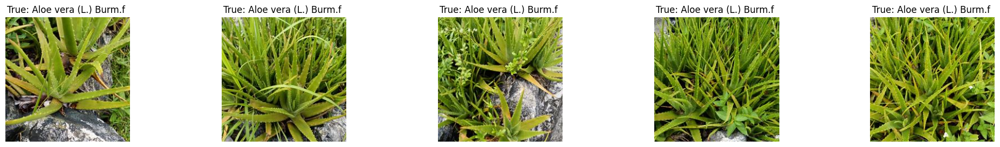


Cluster 11 (Total samples: 22)
True label distribution:
- Aloe vera (L.) Burm.f: 22 samples


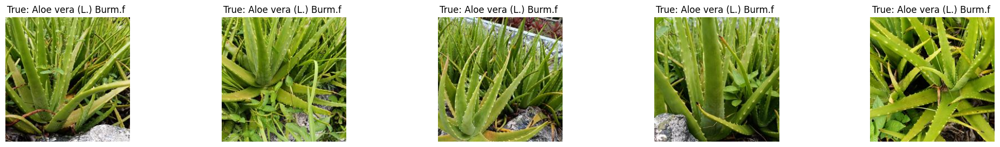


Cluster 12 (Total samples: 75)
True label distribution:
- Amorphophallus paeoniifolius (Dennst.) Nicolson: 67 samples
- Borassodendron borneensis J. Dransf: 3 samples
- Bougainvillea spectabilis: 5 samples


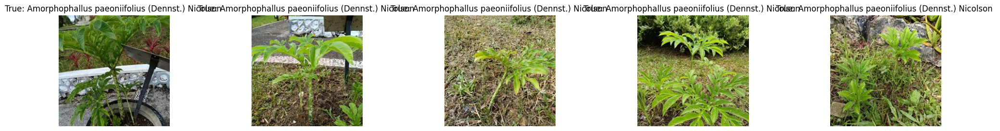


Cluster 13 (Total samples: 104)
True label distribution:
- Amorphophallus paeoniifolius (Dennst.) Nicolson: 3 samples
- Asystasia gangetica (L.) T.Anderson: 1 samples
- Bougainvillea spectabilis: 1 samples
- Duranta erecta L: 99 samples


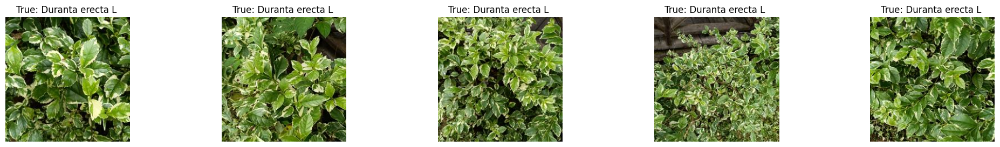


Cluster 14 (Total samples: 117)
True label distribution:
- Asystasia gangetica (L.) T.Anderson: 99 samples
- Bougainvillea spectabilis: 18 samples


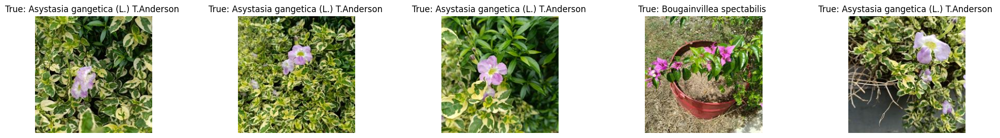


Cluster 15 (Total samples: 104)
True label distribution:
- Borassodendron borneensis J. Dransf: 97 samples
- Cocos nucifera L: 7 samples


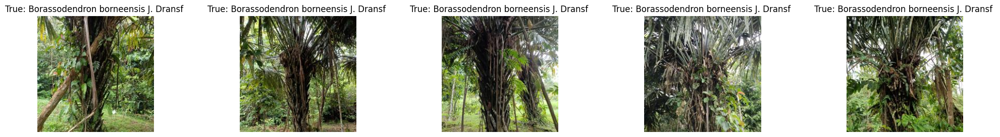


Cluster 16 (Total samples: 71)
True label distribution:
- Bougainvillea spectabilis: 71 samples


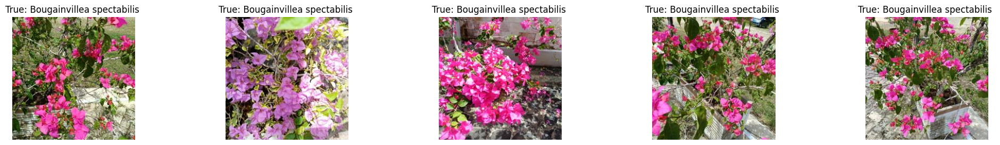


Cluster 17 (Total samples: 105)
True label distribution:
- Bougainvillea spectabilis: 4 samples
- Cornus alba L: 100 samples
- Duranta erecta L: 1 samples


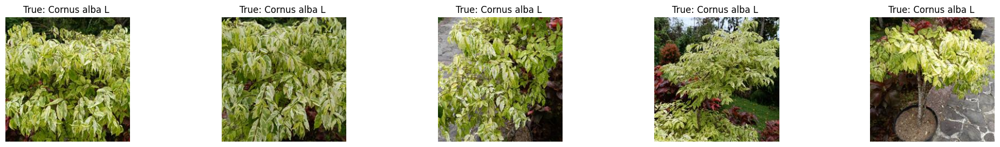


Cluster 18 (Total samples: 46)
True label distribution:
- Cocos nucifera L: 46 samples


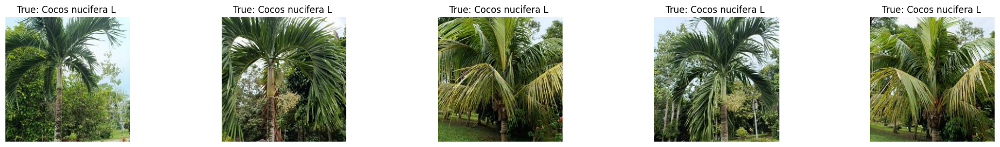


Cluster 19 (Total samples: 47)
True label distribution:
- Cocos nucifera L: 47 samples


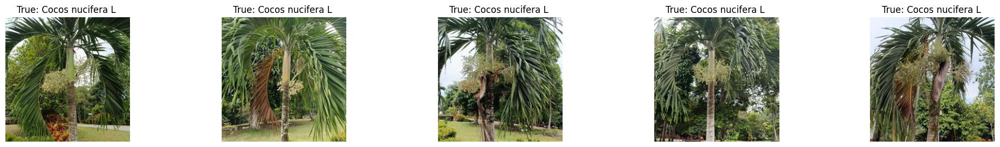


Cluster 20 (Total samples: 100)
True label distribution:
- Cordyline fruticosa (L.) A. Chev: 100 samples


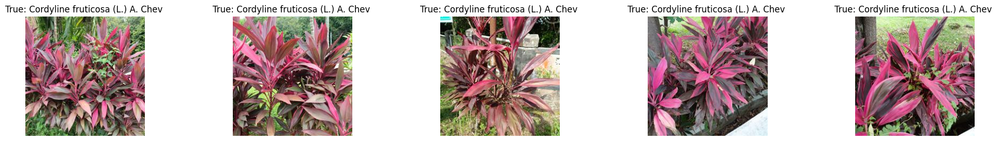


Cluster 21 (Total samples: 99)
True label distribution:
- Costus woodsonii Maas: 98 samples
- Excoecaria cochinchinensis Lour: 1 samples


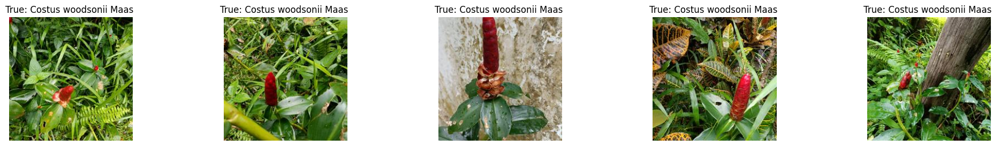


Cluster 22 (Total samples: 98)
True label distribution:
- Dracaena reflexa Lam: 98 samples


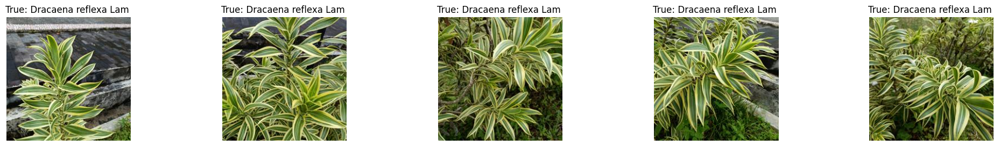

In [11]:
# Visualisasi hasil FINCH
def visualize_finch_clusters(features, true_labels, pred_labels, sample_size=1000):
    # Sample acak untuk visualisasi
    sample_idx = np.random.choice(len(features), sample_size, replace=False)
    sample_feat = features[sample_idx]
    sample_true = true_labels[sample_idx]
    sample_pred = pred_labels[sample_idx]
    
    # Reduksi dimensi dengan t-SNE
    tsne = TSNE(n_components=2, perplexity=30, random_state=42)
    tsne_results = tsne.fit_transform(sample_feat)
    
    # Plot
    plt.figure(figsize=(15, 6))
    
    # True labels
    plt.subplot(1, 2, 1)
    scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], 
                         c=sample_true, cmap='tab20', alpha=0.6)
    plt.title("True Novel Classes")
    plt.colorbar(scatter, ticks=np.unique(sample_true))
    
    # Predicted clusters
    plt.subplot(1, 2, 2)
    scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], 
                         c=sample_pred, cmap='tab20', alpha=0.6)
    plt.title("FINCH Discovered Clusters")
    plt.colorbar(scatter, ticks=np.unique(sample_pred))
    
    plt.tight_layout()
    plt.show()

visualize_finch_clusters(unlabeled_features, unlabeled_true_labels, clusters)

def denormalize(image):
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    return image * std + mean

# Fungsi untuk menampilkan contoh per cluster
def show_finch_samples(cluster_labels, true_labels, dataset, samples_per_cluster=5):
    unique_clusters = np.unique(cluster_labels)
    
    for cluster_id in unique_clusters:
        # Dapatkan indeks untuk cluster ini
        cluster_indices = np.where(cluster_labels == cluster_id)[0]
        
        # Hitung distribusi kelas sebenarnya dalam cluster
        cluster_true_labels = true_labels[cluster_indices]
        unique, counts = np.unique(cluster_true_labels, return_counts=True)
        
        # Ambil sampel acak
        samples = np.random.choice(cluster_indices, 
                                  min(samples_per_cluster, len(cluster_indices)), 
                                  replace=False)
        
        # Tampilkan informasi cluster
        print(f"\nCluster {cluster_id} (Total samples: {len(cluster_indices)})")
        print("True label distribution:")
        for lbl, cnt in zip(unique, counts):
            print(f"- {dataset.classes[lbl]}: {cnt} samples")
        
        # Tampilkan gambar
        plt.figure(figsize=(25, 3))
        for i, idx in enumerate(samples):
            image, _ = dataset[idx]
            plt.subplot(1, samples_per_cluster, i+1)
            plt.imshow(denormalize(image).permute(1, 2, 0))
            plt.title(f"True: {dataset.classes[true_labels[idx]]} ")
            plt.axis('off')
        plt.show()

show_finch_samples(clusters, unlabeled_true_labels, unlabel_dataset)